In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import openpyxl
import statsmodels.api as sm

data_dir="/Users/shaunwarrington/Documents/baby_xtract_git/Data"

In [2]:
FA = pd.read_csv(f"{data_dir}/FA_0.001.txt", header=None, sep=",", names=["subID", "sesID","tract", "FA"])
MD = pd.read_csv(f"{data_dir}/MD_0.001.txt", header=None, sep=",", names=["subID", "sesID","tract", "MD"])

In [3]:
DTI_all = pd.merge(FA, MD, how="left")

In [4]:
info = pd.read_excel(f"{data_dir}/FINAL_dHCP_all_subjects_for_release.xlsx", 
                     header=2, names=["multiple_scans", "singleton", "subID","sesID","age at scan","age_at_birth",
                                     "sex","birth_weight", "head_circ", "rad_score"])
info = info[["subID", "sesID", "age at scan", "age_at_birth", "sex", "birth_weight", "head_circ", "rad_score"]]
info["sesID"] = "ses-" + info["sesID"].astype("str")


In [6]:
QC = pd.read_csv(f"{data_dir}/data_summary_QC.csv",index_col=0, header=0, names=["subID", "sesID", "scan_date", "QC","dMRI_out_of_FOV", "dMRI_pass"])
QC = QC[["subID","sesID", "QC"]]
QC["sesID"] = "ses-" + QC["sesID"]

In [32]:
info.describe()

,age at scan,age_at_birth
count,569.000000,569.000000
mean,39.940999,37.389154
std,3.062114,4.230614
min,29.285714,24.285714
25%,38.571429,35.142857
50%,40.571429,39.142857
75%,41.857143,40.428571
max,45.142857,42.285714


In [10]:
tract_vols = pd.read_csv(f"{data_dir}/tract_vols.txt",header=None, sep=",", names=["subID", "sesID", "tract", "volume"])
DTI_all = pd.merge(DTI_all, tract_vols, how="left")


In [11]:
df=pd.merge(QC, info, how="left")
df=pd.merge(df, DTI_all, how="left")
x = df.tract.str.split('_')
df['hemi'] = np.nan
df['tract'] = np.nan
for i, row in enumerate(x):
    if hasattr(row, "__len__"):
        df.loc[i,'tract'] = row[0]
        if len(row) == 2:
            df.loc[i,'hemi'] = row[1]
        else:
            df.loc[i,'hemi'] = "both"

In [12]:
tract_types = {"slf1":"association", "slf2":"association", "slf3":"association", "af":"association",
               "mdlf":"association", "ilf":"association", "ifo":"association", "uf":"association", 
               "fa":"association", "vof":"association", "mcp":"commissural", "fma":"commissural", 
               "fmi":"commissural", "ac":"commissural", "cbt":"limbic", "cbp":"limbic", "cbd":"limbic", 
               "fx":"limbic", "cst":"projection", "atr":"projection", "str":"projection", "ar":"projection",
               "or":"projection"}


df = df.dropna()
df["tract type"] = df["tract"].map(tract_types)
df = df.sort_values(by=["tract type", "tract"])

In [31]:
# remove premature neonates from data
df = df.drop(df[df.age_at_birth < 37].index)
df.describe()

,QC,age at scan,age_at_birth,FA,MD,volume
count,11634.000000,11634.000000,11634.000000,11634.000000,11634.000000,11634.000000
mean,0.253786,40.955647,39.942754,0.203705,0.001274,4878.316524
std,0.631973,1.687967,1.221334,0.032211,0.000124,2265.620504
min,-1.913938,37.428571,37.142857,0.119818,0.000923,300.750732
25%,-0.111180,39.714286,39.142857,0.180513,0.001194,3187.236695
50%,0.304307,40.857143,40.142857,0.202856,0.001282,4938.697754
75%,0.708024,42.000000,40.857143,0.225731,0.001357,6607.761475
max,1.604771,44.714286,42.285714,0.326296,0.001760,11842.574219


In [38]:
np.unique(df.subID.values).shape

(277,)

In [36]:
# plt.figure(figsize=(100, 100), dpi=200)

# df = df[df.tract == 'af']

# g = sns.lmplot(x="age at scan", y="FA", col="tract", hue="tract type", data=df,
#                scatter_kws={"alpha":0.1})

# plt.tick_params(
#     axis='x',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     bottom=False,      # ticks along the bottom edge are off
#     top=False,         # ticks along the top edge are off
#     labelbottom=False) # labels along the bottom edge are off

# plt.tick_params(
#     axis='y',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     left=False,      # ticks along the bottom edge are off
#     right=False,         # ticks along the top edge are off
#     labelleft=False) # labels along the bottom edge are off

# plt.xlabel('Age', fontsize=24)
# plt.ylabel('FA', fontsize=24)

In [17]:
df_beta = pd.DataFrame()
tract_names = df.tract.unique()[:]
for t in tract_names:
    data = df.replace("not available", np.nan)
    data = data.dropna().drop_duplicates()
    data = data[data.tract == t]
    x = data[["age at scan", "birth_weight","head_circ","QC","volume"]]
    x = (x - x.mean())/x.std()
    
    for metric in ["MD", "FA"]:
        y = (data[metric] - data[metric].mean())/data[metric].std()
        model = sm.GLM(y, sm.add_constant(x).astype(float))
        results = model.fit()
        #print(t, results.params[1], results.pvalues[1])
        df_beta = df_beta.append({
            "rate of change with age":results.params[1],
            "pval":results.pvalues[1],
            "tract":t,
            "tract type":tract_types[t],
            "metric":metric
        }, ignore_index=True)


Text(0.5, 0, 'Tract')

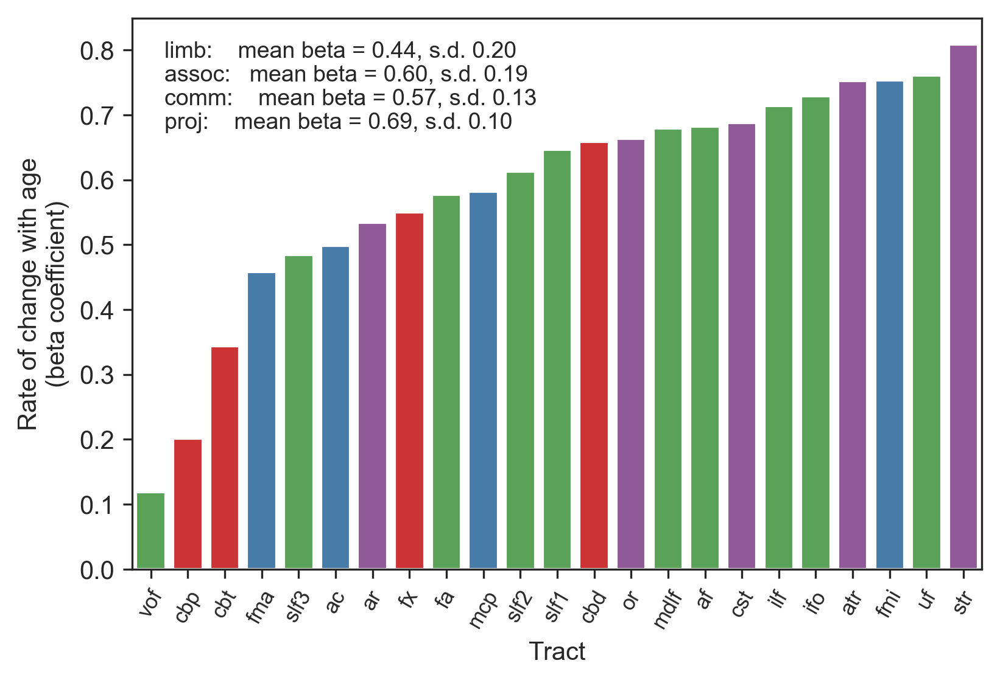

In [18]:
sns.set_style("ticks")
plt.rcParams['figure.dpi'] = 300

df_beta = df_beta.sort_values(by="rate of change with age")
g=sns.barplot(data=df_beta[df_beta.metric=="FA"], x="tract", y="rate of change with age", hue="tract type",
                dodge=False, palette="Set1",hue_order=[ "limbic", "commissural","association","projection"])
plt.xticks(rotation=60, fontsize="small")
g.legend_.remove()
# plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')

# annotate tract type mean and standard deviations
mn = df_beta[df_beta['metric'] == 'FA'].groupby('tract type').mean()
sd = df_beta[df_beta['metric'] == 'FA'].groupby('tract type').std()

mn = mn.reindex(['limbic', 'association', 'commissural', 'projection'])
sd = sd.reindex(['limbic', 'association', 'commissural', 'projection'])
mn = mn.rename(index={'limbic':'limb', 'association':'assoc', 'commissural':'comm', 'projection':'proj'})

txt = ""
for m, s in zip(mn.iterrows(), sd.iterrows()):
    item = f'{m[0]}: \t mean beta = {m[1][0]:.2f}, s.d. {s[1][0]:.2f}\n'
    txt += item
    
plt.annotate(txt.expandtabs(), xy=(0.15, 0.88), ha='left', va='top', fontsize=9, xycoords='figure fraction')
plt.ylabel('Rate of change with age\n(beta coefficient)')
plt.xlabel('Tract')


Text(0.5, 0, 'Tract')

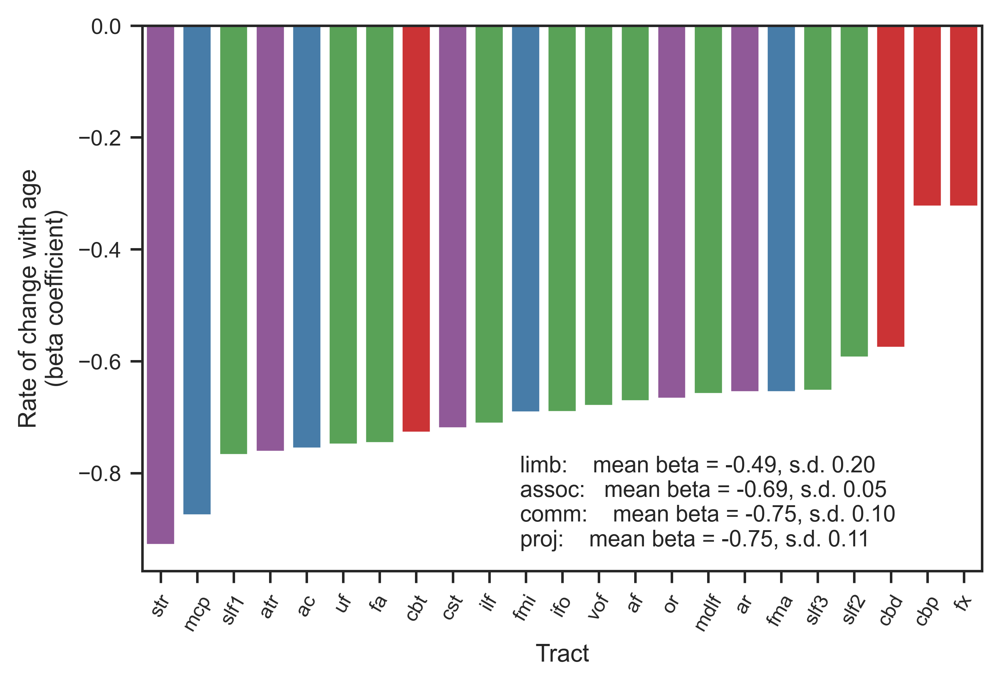

In [19]:
plt.figure(dpi=500)
sns.set_context("paper")
g = sns.barplot(data=df_beta[df_beta.metric=="MD"], x="tract", y="rate of change with age", hue="tract type", dodge=False, 
                palette="Set1",hue_order=[ "limbic", "commissural","association","projection"])
plt.xticks(rotation=60, fontsize="small")
g.legend_.remove()

# annotate tract type mean and standard deviations
mn = df_beta[df_beta['metric'] == 'MD'].groupby('tract type').mean()
sd = df_beta[df_beta['metric'] == 'MD'].groupby('tract type').std()

mn = mn.reindex(['limbic', 'association', 'commissural', 'projection'])
sd = sd.reindex(['limbic', 'association', 'commissural', 'projection'])
mn = mn.rename(index={'limbic':'limb', 'association':'assoc', 'commissural':'comm', 'projection':'proj'})

txt = ""
for m, s in zip(mn.iterrows(), sd.iterrows()):
    item = f'{m[0]}: \t mean beta = {m[1][0]:.2f}, s.d. {s[1][0]:.2f}\n'
    txt += item
    
plt.annotate(txt.expandtabs(), xy=(0.48, 0.15), ha='left', va='bottom', fontsize=9, xycoords='figure fraction')
plt.ylabel('Rate of change with age\n(beta coefficient)')
plt.xlabel('Tract')


In [20]:
df_beta.groupby(['tract type', 'metric']).describe()

rate of change with age                                \
                                     count      mean       std       min   
tract type  metric                                                         
association FA                        10.0  0.600573  0.187650  0.118512   
            MD                        10.0 -0.692375  0.053180 -0.768184   
commissural FA                         4.0  0.573253  0.130936  0.458239   
            MD                         4.0 -0.745009  0.096935 -0.876137   
limbic      FA                         4.0  0.438602  0.204827  0.201749   
            MD                         4.0 -0.487884  0.199643 -0.728141   
projection  FA                         5.0  0.689275  0.103702  0.534070   
            MD                         5.0 -0.746756  0.110307 -0.928731   

                                                            pval  \
                         25%       50%       75%       max count   
tract type  metric                                                 
association FA      0.585835  0.663168  0.705904  0.761217  10.0   
            MD     -0.738123 -0.685474 -0.661884 -0.593338  10.0   
commissural FA      0.488630  0.540518  0.625140  0.753736   4.0   
            MD     -0.786538 -0.724256 -0.682728 -0.655388   4.0   
limbic      FA      0.308475  0.447000  0.577127  0.658658   4.0   
            MD     -0.614289 -0.449958 -0.323553 -0.323481   4.0   
projection  FA      0.663667  0.687412  0.752470  0.808752   5.0   
            MD     -0.762108 -0.719931 -0.667188 -0.655822   5.0   

                                                                              \
                            mean           std            min            25%   
tract type  metric                                                             
association FA      1.440689e-03  4.555857e-03  7.282525e-133   3.414785e-87   
            MD      2.741137e-41  8.668237e-41  1.774830e-111   5.830343e-71   
commissural FA      4.900979e-09  9.801921e-09   9.913187e-54   1.134439e-14   
            MD      6.586598e-28  1.274979e-27   1.000191e-39   4.294684e-39   
limbic      FA      4.231608e-06  8.463203e-06   9.926087e-77   8.664439e-36   
            MD      2.228442e-11  4.230717e-11   7.009681e-69   1.911508e-39   
projection  FA      5.105161e-33  1.141549e-32  4.375739e-142   1.443673e-91   
            MD      1.146176e-47  2.560819e-47  2.018870e-131  3.952186e-113   

                                                              
                             50%           75%           max  
tract type  metric                                            
association FA      1.055528e-48  1.013518e-37  1.440689e-02  
            MD      4.670056e-67  4.751262e-66  2.741137e-40  
commissural FA      2.804871e-14  4.900996e-09  1.960386e-08  
            MD      3.202370e-29  6.906835e-28  2.570592e-27  
limbic      FA      9.903308e-12  4.231618e-06  1.692641e-05  
            MD      1.719561e-12  2.400399e-11  8.569857e-11  
projection  FA      3.412305e-83  1.263518e-47  2.552580e-32  
            MD      5.445401e-69  3.772917e-50  5.727108e-47

In [21]:
df_beta[df_beta.tract == "str"]

,rate of change with age,pval,tract,tract type,metric
44,-0.928731,3.952186e-113,str,projection,MD
45,0.808752,3.412305e-83,str,projection,FA


In [22]:
df_beta[df_beta.tract == "cbp"]

,rate of change with age,pval,tract,tract type,metric
30,-0.323577,8.569857e-11,cbp,limbic,MD
31,0.201749,1.692641e-05,cbp,limbic,FA


Text(0.5, 96.84000000000002, 'Age at Scan (weeks)')

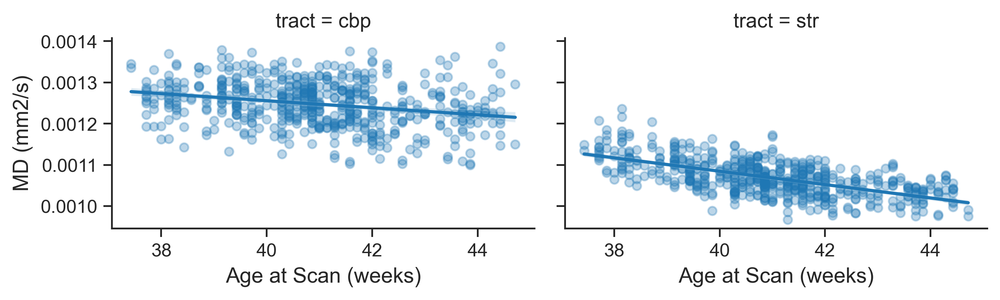

In [23]:
sns.set_context("paper", font_scale=1.2)

# plot STR for example fast tract
g = sns.lmplot(x="age at scan", y="MD", col='tract', data=df[df.tract.isin(['str', 'cbp'])], 
           scatter_kws={"alpha":0.3}, palette="cividis", height=2.5, aspect=1.6)

# g.axes[0][0].ticklabel_format(style='sci', scilimits=(0.001, 0.0014), axis='y')
g.axes[0][0].set_ylabel('MD (mm2/s)', fontsize = 12)
g.axes[0][0].set_xlabel('Age at Scan (weeks)', fontsize = 12)
g.axes[0][1].set_xlabel('Age at Scan (weeks)', fontsize = 12)

Text(0.5, 96.84000000000002, 'Age at Scan (weeks)')

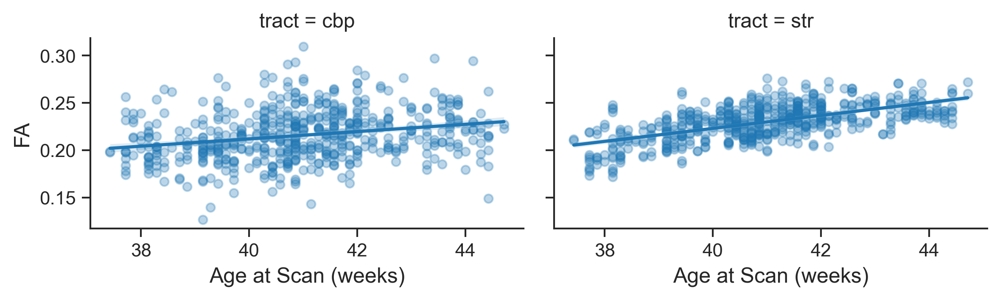

In [24]:
g = sns.lmplot(x="age at scan", y="FA", col='tract', data=df[df.tract.isin(['str', 'cbp'])], 
           scatter_kws={"alpha":0.3}, palette="cividis", height=2.5, aspect=1.6)

g.axes[0][0].set_ylabel('FA', fontsize = 12)
g.axes[0][0].set_xlabel('Age at Scan (weeks)', fontsize = 12)
g.axes[0][1].set_xlabel('Age at Scan (weeks)', fontsize = 12)

In [65]:
df_beta

,rate of change with age,pval,tract,tract type,metric
26,-1.143242,3.692040e-72,mcp,commissural,MD
44,-1.044911,5.329942e-187,str,projection,MD
20,-0.982282,1.923872e-74,ac,commissural,MD
10,-0.947275,3.320138e-130,slf1,association,MD
2,-0.934730,8.396653e-116,fa,association,MD
40,-0.928453,7.700866e-112,cst,projection,MD
32,-0.914725,5.597436e-118,cbt,limbic,MD
16,-0.903905,1.932603e-163,uf,association,MD
38,-0.895214,9.754693e-210,atr,projection,MD
6,-0.855954,2.357293e-107,ilf,association,MD


In [28]:
plt.figure(dpi=1000)

with sns.plotting_context("poster", font_scale=1.5):
    g = sns.lmplot(x="age at scan", y="FA", col="tract", data=df,
                   col_wrap=5, truncate=False,scatter_kws={"alpha":0.1}, palette="cividis")

temp = [plt.setp(ax.get_xticklabels(), rotation=30, fontsize = 25) for ax in g.axes.flat]

for ax in g.axes.flatten():
    row = df_beta[(df_beta.tract == ax.get_title().split('= ')[1]) & (df_beta.metric == 'FA')]
    beta = row['rate of change with age'].values[0]
    p = row['pval'].values[0]
    txt = f'beta = {beta:.3f}'
    if p < 0.01/df_beta.shape[0]:
        txt = f'{txt}*'
    ax.text(40, 0.3, txt, fontsize=26)

<Figure size 6000x4000 with 0 Axes>

In [29]:
with sns.plotting_context("poster", font_scale=1.5):
    g = sns.lmplot(x="age at scan", y="MD", col="tract", data=df,
                   col_wrap=5, truncate=False, scatter_kws={"alpha":0.1}, palette="inferno")


temp = [plt.setp(ax.get_xticklabels(), rotation=30, fontsize = 25) for ax in g.axes.flat]
temp = [plt.setp(ax.get_yticklabels(), fontsize = 25) for ax in g.axes.flat]

for ax in g.axes.flatten():
    row = df_beta[(df_beta.tract == ax.get_title().split('= ')[1]) & (df_beta.metric == 'MD')]
    beta = row['rate of change with age'].values[0]
    p = row['pval'].values[0]
    txt = f'beta = {beta:.3f}'
    if p < 0.01/df_beta.shape[0]:
        txt = f'{txt}*'
    ax.text(40, 0.0017, txt, fontsize=26)
